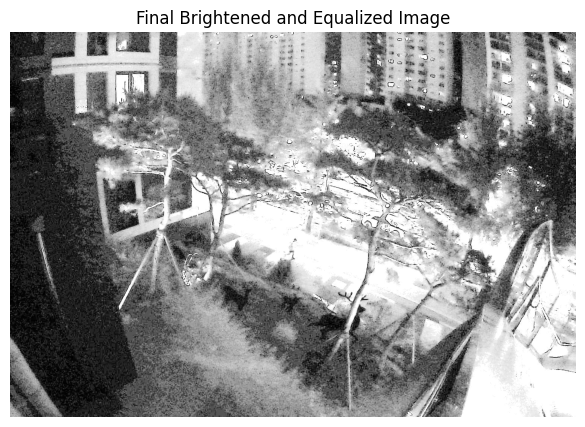

'/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2_1_05_50.jpg'

In [ ]:
import cv2
import numpy as np

# Load the input image
input_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'
output_image_path_final = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2_1_05_50.jpg'



# Read the image in grayscale
img = cv2.imread(input_image_path, cv2.IMREAD_GRAYSCALE)

# Increase brightness
alpha = 0.5 # Contrast control (1.0 means no change)
beta = 10 # Brightness control (higher value to increase brightness more)

bright_img = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)

# Reduce overexposed areas
def reduce_overexposure(image, limit=240):
    """ Reduce brightness of overexposed areas """
    image = np.where(image > limit, limit, image)
    return image

adjusted_img = cv2.equalizeHist(bright_img)

# Apply histogram equalization
equalized_img = reduce_overexposure(adjusted_img)

# Save the processed image
cv2.imwrite(output_image_path_final, equalized_img)

# Display the processed image
plt.figure(figsize=(10, 5))
plt.title('Final Brightened and Equalized Image')
plt.imshow(equalized_img, cmap='gray')
plt.axis('off')
plt.show()

output_image_path_final

# # Read the image in grayscale
# img = cv2.imread(input_image_path, cv2.IMREAD_GRAYSCALE)

# # Increase brightness and decrease contrast
# alpha = 1.0# Contrast control (1.0 means no change)
# beta = 200# Brightness control

# bright_img = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)

# # Reduce overexposed areas
# def reduce_overexposure(image, limit=200):
#     """ Reduce brightness of overexposed areas """
#     image = np.where(image > limit, limit, image)
#     return image

# adjusted_img = reduce_overexposure(bright_img)

# # Save the processed image
# cv2.imwrite(output_image_path_final, adjusted_img)

# # Display the processed image
# plt.figure(figsize=(10, 5))
# plt.title('Final Adjusted Image')
# plt.imshow(adjusted_img, cmap='gray')
# plt.axis('off')
# plt.show()

# output_image_path_final


In [ ]:
!pip install opencv-python-headless

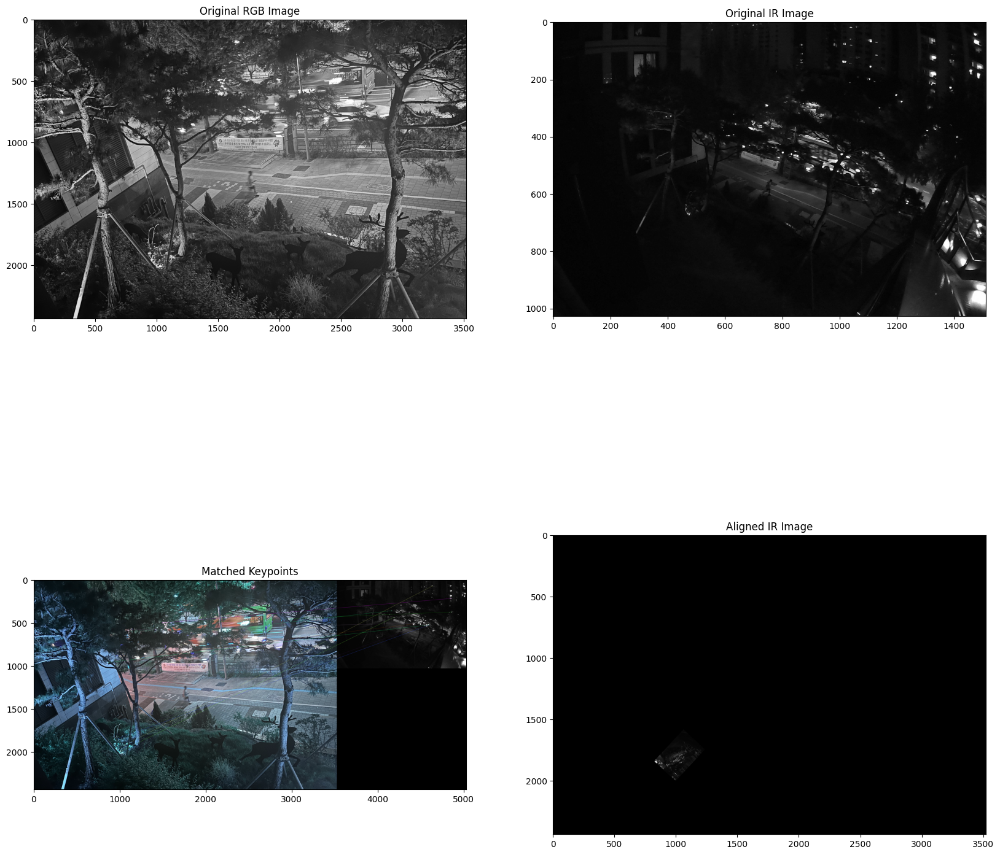

In [ ]:
import cv2
import numpy as np
from google.colab import files
from matplotlib import pyplot as plt



# 업로드한 이미지 파일명 가져오기
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'

import cv2
import numpy as np
from matplotlib import pyplot as plt
from google.colab import drive


# # 이미지 경로 설정
# rgb_image_path = '/content/drive/My Drive/your_rgb_image.jpg'  # RGB 이미지 경로
# ir_image_path = '/content/drive/My Drive/your_ir_image.jpg'    # IR 이미지 경로


rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(ir_image, cv2.COLOR_BGR2GRAY)



# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 10개의 매칭점 사용
matches = matches[:10]

# 매칭점 그리기
img_matches = cv2.drawMatches(rgb_image, keypoints_rgb, ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = rgb_image.shape
ir_aligned = cv2.warpAffine(ir_image, matrix, (width, height))

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.title('Original RGB Image')
plt.imshow(cv2.cvtColor(gray_rgb, cv2.COLOR_BGR2RGB))

plt.subplot(2, 2, 2)
plt.title('Original IR Image')
plt.imshow(cv2.cvtColor(gray_ir, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 2, 3)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 2, 4)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()

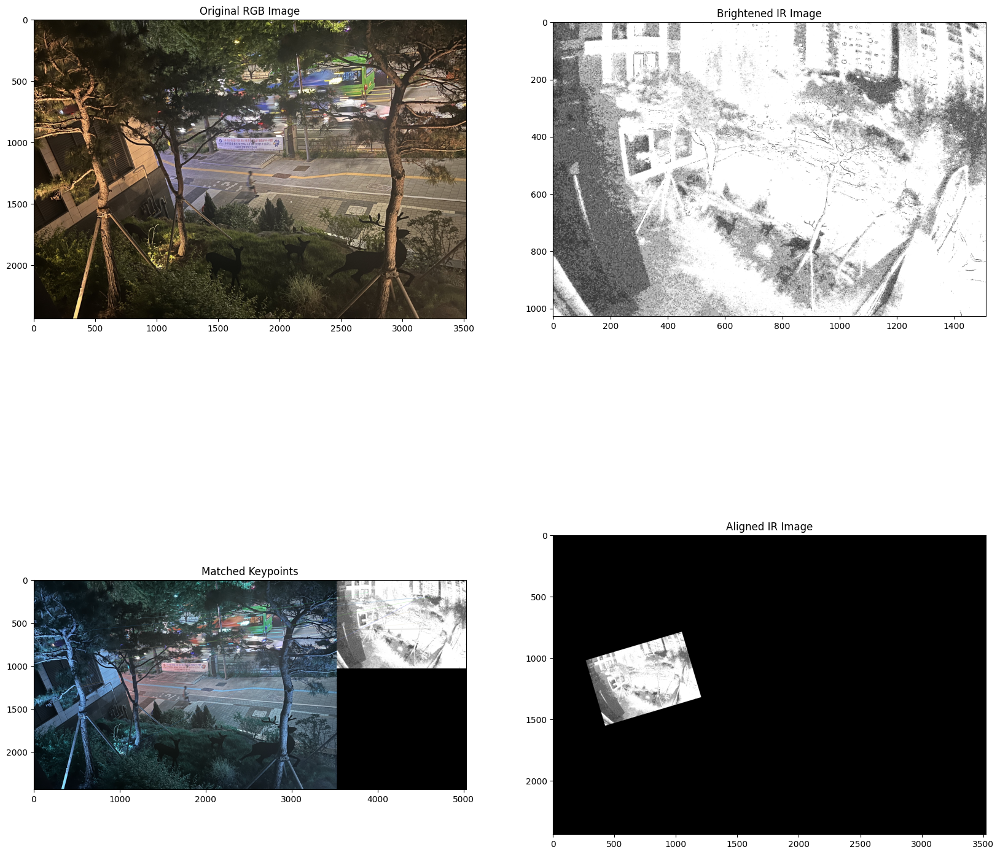

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로

# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# IR 이미지의 밝기 조절
alpha = 1.5  # Contrast control (1.0-3.0)
beta = 50    # Brightness control (0-100)

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 10개의 매칭점 사용
matches = matches[:10]

# 매칭점 그리기
img_matches = cv2.drawMatches(rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.title('Original RGB Image')
plt.imshow(cv2.cvtColor(rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(2, 2, 2)
plt.title('Brightened IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 2, 3)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 2, 4)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()


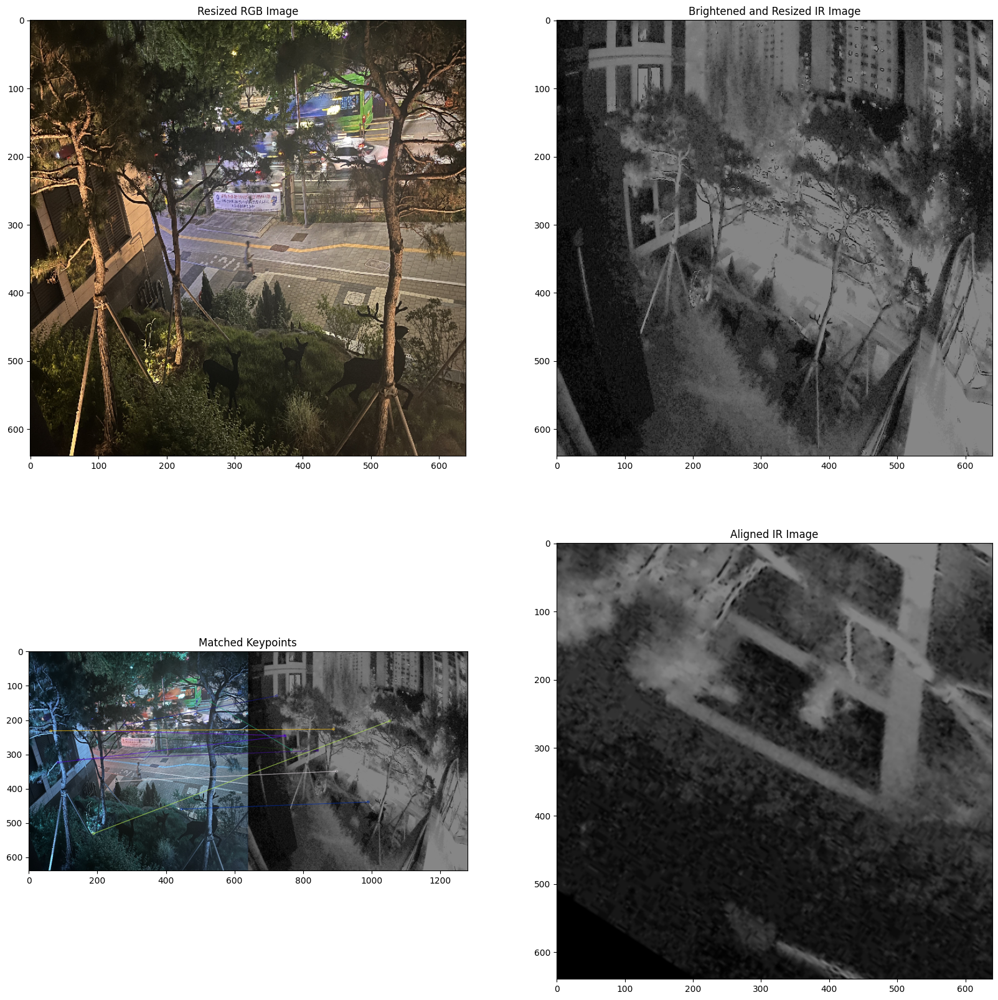

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로

# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 10개의 매칭점 사용
matches = matches[:10]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(2, 2, 2)
plt.title('Brightened and Resized IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 2, 3)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 2, 4)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()



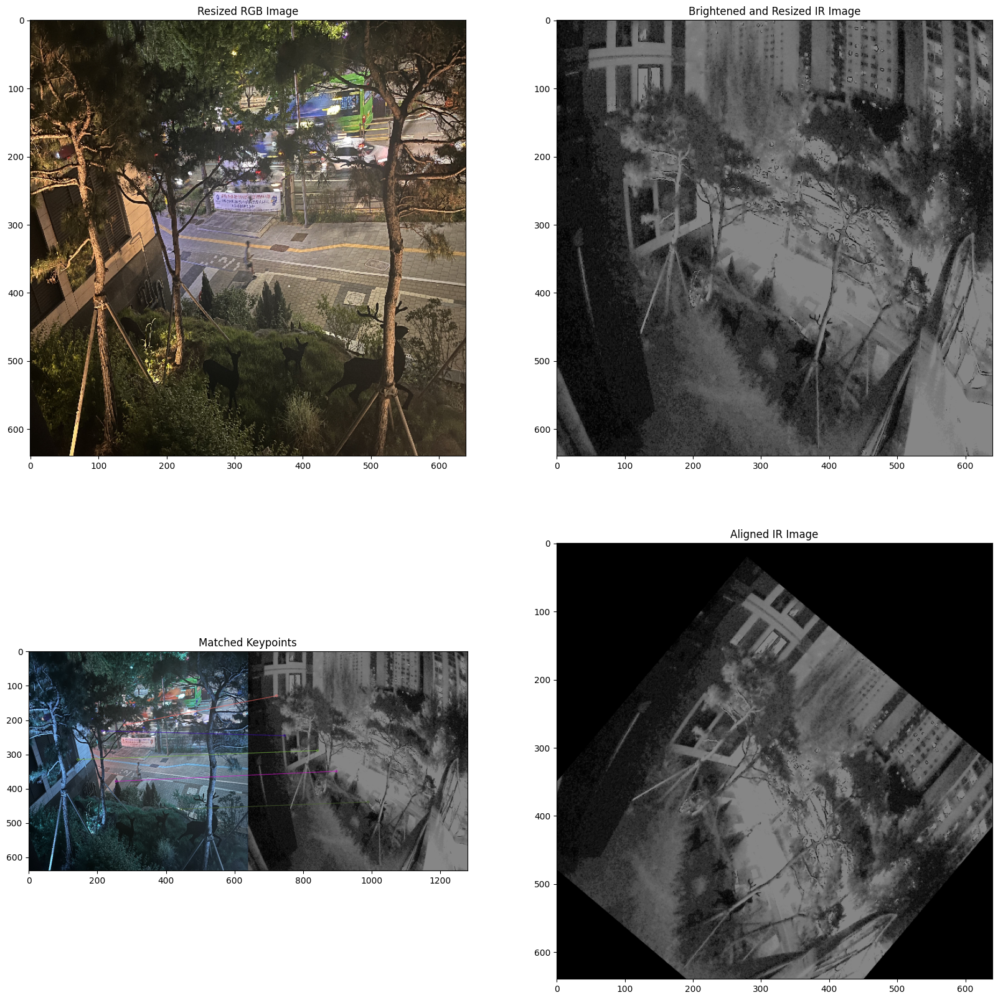

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로

# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 5개의 매칭점 사용
matches = matches[:5]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(2, 2, 2)
plt.title('Brightened and Resized IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 2, 3)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 2, 4)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()


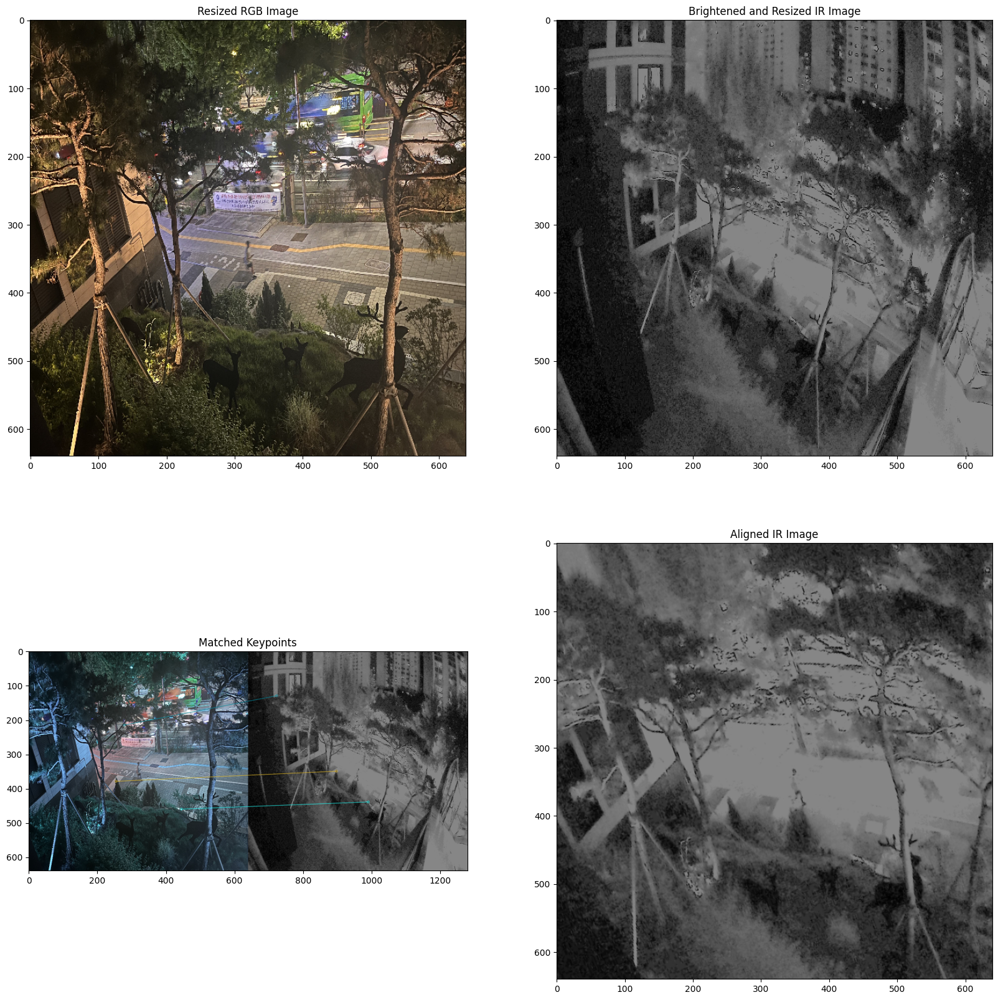

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로

# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 3개의 매칭점 사용
matches = matches[:3]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(2, 2, 2)
plt.title('Brightened and Resized IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 2, 3)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 2, 4)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()


In [ ]:
cd /content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process

/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process


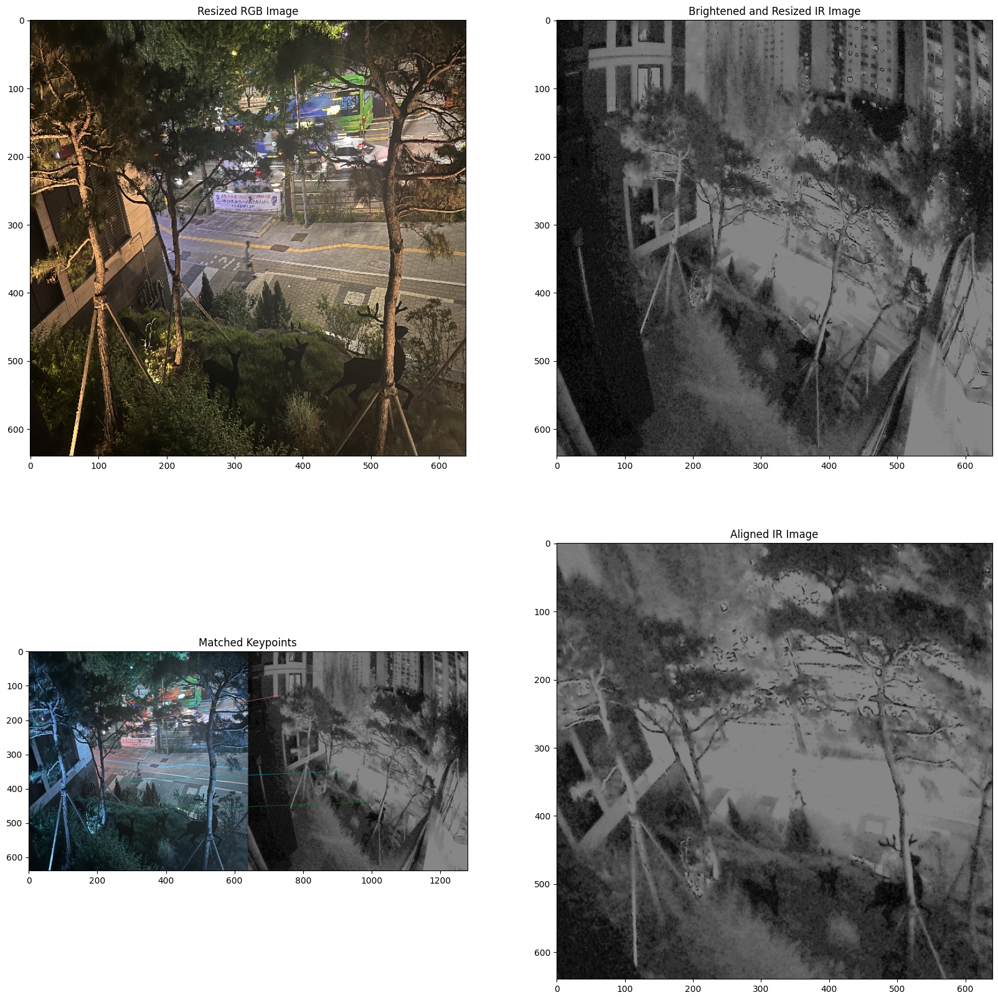

In [ ]:
#가장 좋은 성과 ->

import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로

# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 3개의 매칭점 사용
matches = matches[:3]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 정렬된 IR 이미지 저장
# aligned_ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/aligned_rgb_image.jpg'
# cv2.imwrite(aligned_ir_image_path, ir_aligned)

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

# # 정렬된 IR 이미지 저장
# aligned_rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/aligned_rgb_image.jpg'
# cv2.imwrite(aligned_rgb_image_path, resized_rgb_image)

plt.subplot(2, 2, 2)
plt.title('Brightened and Resized IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 2, 3)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 2, 4)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()


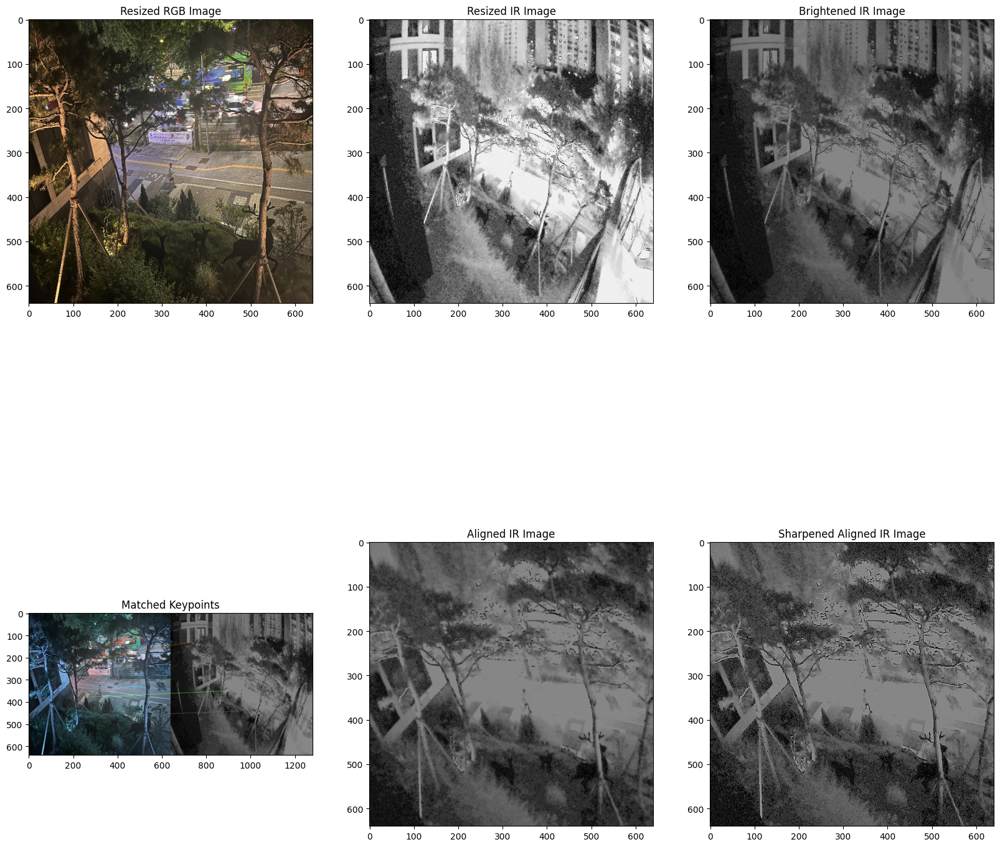

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# # 이미지 경로 설정
# rgb_image_path = '/mnt/data/test_rgb2.jpg'  # RGB 이미지 경로
# ir_image_path = '/mnt/data/test_ir2.jpg'    # IR 이미지 경로

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로


# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 3개의 매칭점 사용
matches = matches[:3]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 정렬된 IR 이미지에 샤프닝 적용
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])
sharpened_ir_aligned = cv2.filter2D(ir_aligned, -1, kernel)

# 정렬된 IR 이미지 저장
aligned_ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/sharpened_aligned_rgb_image.jpg'
cv2.imwrite(aligned_ir_image_path, sharpened_ir_aligned)

# aligned_ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/aligned_rgb_image.jpg'
# cv2.imwrite(aligned_ir_image_path, ir_aligned)


# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(2, 3, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(2, 3, 2)
plt.title('Resized IR Image')
plt.imshow(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2RGB))

plt.subplot(2, 3, 3)
plt.title('Brightened IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(2, 3, 4)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(2, 3, 5)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

# 샤프닝된 정렬된 이미지 출력
plt.subplot(2, 3, 6)
plt.title('Sharpened Aligned IR Image')
plt.imshow(cv2.cvtColor(sharpened_ir_aligned, cv2.COLOR_BGR2RGB))

plt.show()



In [ ]:
# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_rgb2.jpg'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/test_ir2.jpg'    # IR 이미지 경로


In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt


# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 3개의 매칭점 사용
matches = matches[:3]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 정렬된 IR 이미지에 샤프닝 적용
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])
sharpened_ir_aligned = cv2.filter2D(ir_aligned, -1, kernel)

# 오프닝과 클로징 연산
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(sharpened_ir_aligned, cv2.MORPH_OPEN, kernel)
closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)

# Salt and Pepper 필터 적용
salt_pepper_image = closing.copy()
prob = 0.02  # 노이즈 비율
black = np.zeros_like(salt_pepper_image)
white = np.ones_like(salt_pepper_image) * 255

# 랜덤한 픽셀 위치에 노이즈 적용
num_salt = np.ceil(prob * salt_pepper_image.size * 0.5)
coords = [np.random.randint(0, i - 1, int(num_salt)) for i in salt_pepper_image.shape]
salt_pepper_image[coords] = 1

num_pepper = np.ceil(prob * salt_pepper_image.size * 0.5)
coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in salt_pepper_image.shape]
salt_pepper_image[coords] = 0

# # 정렬된 IR 이미지 저장
# aligned_ir_image_path = '/mnt/data/aligned_ir_image.jpg'
# cv2.imwrite(aligned_ir_image_path, salt_pepper_image)

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(3, 3, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(3, 3, 2)
plt.title('Resized IR Image')
plt.imshow(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2RGB))

plt.subplot(3, 3, 3)
plt.title('Brightened IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(3, 3, 4)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(3, 3, 5)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

# 샤프닝된 정렬된 이미지 출력
plt.subplot(3, 3, 6)
plt.title('Sharpened Aligned IR Image')
plt.imshow(cv2.cvtColor(sharpened_ir_aligned, cv2.COLOR_BGR2RGB))

# 오프닝과 클로징된 이미지 출력
plt.subplot(3, 3, 7)
plt.title('Opening and Closing')
plt.imshow(cv2.cvtColor(closing, cv2.COLOR_BGR2RGB))

# Salt and Pepper 이미지 출력
plt.subplot(3, 3, 8)
plt.title('Salt and Pepper Image')
plt.imshow(cv2.cvtColor(salt_pepper_image, cv2.COLOR_BGR2RGB))

plt.show()


In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# # 이미지 경로 설정
# rgb_image_path = '/mnt/data/test_rgb2.jpg'  # RGB 이미지 경로
# ir_image_path = '/mnt/data/test_ir2.jpg'    # IR 이미지 경로

# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 3개의 매칭점 사용
matches = matches[:3]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 정렬된 IR 이미지에 샤프닝 적용
kernel = np.array([[0, -2, 0],
                   [-2, 10, -2],
                   [0, -2, 0]])
sharpened_ir_aligned = cv2.filter2D(ir_aligned, -1, kernel)

# 오프닝과 클로징 연산
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(sharpened_ir_aligned, cv2.MORPH_OPEN, kernel)
closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)

# Max 필터 적용
max_filtered_image = cv2.dilate(closing, kernel)

# # 정렬된 IR 이미지 저장
# aligned_ir_image_path = '/mnt/data/aligned_ir_image.jpg'
# cv2.imwrite(aligned_ir_image_path, max_filtered_image)

# 시각화
plt.figure(figsize=(20, 20))

# 원본 이미지 출력
plt.subplot(3, 3, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(3, 3, 2)
plt.title('Resized IR Image')
plt.imshow(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2RGB))

plt.subplot(3, 3, 3)
plt.title('Brightened IR Image')
plt.imshow(cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2RGB))

# 매칭 결과 이미지 출력
plt.subplot(3, 3, 4)
plt.title('Matched Keypoints')
plt.imshow(img_matches)

# 정렬된 이미지 출력
plt.subplot(3, 3, 5)
plt.title('Aligned IR Image')
plt.imshow(cv2.cvtColor(ir_aligned, cv2.COLOR_BGR2RGB))

# 샤프닝된 정렬된 이미지 출력
plt.subplot(3, 3, 6)
plt.title('Sharpened Aligned IR Image')
plt.imshow(cv2.cvtColor(sharpened_ir_aligned, cv2.COLOR_BGR2RGB))

# 오프닝과 클로징된 이미지 출력
plt.subplot(3, 3, 7)
plt.title('Opening and Closing')
plt.imshow(cv2.cvtColor(closing, cv2.COLOR_BGR2RGB))

# Max 필터 이미지 출력
plt.subplot(3, 3, 8)
plt.title('Max Filter Image')
plt.imshow(cv2.cvtColor(max_filtered_image, cv2.COLOR_BGR2RGB))

plt.show()


## 최종

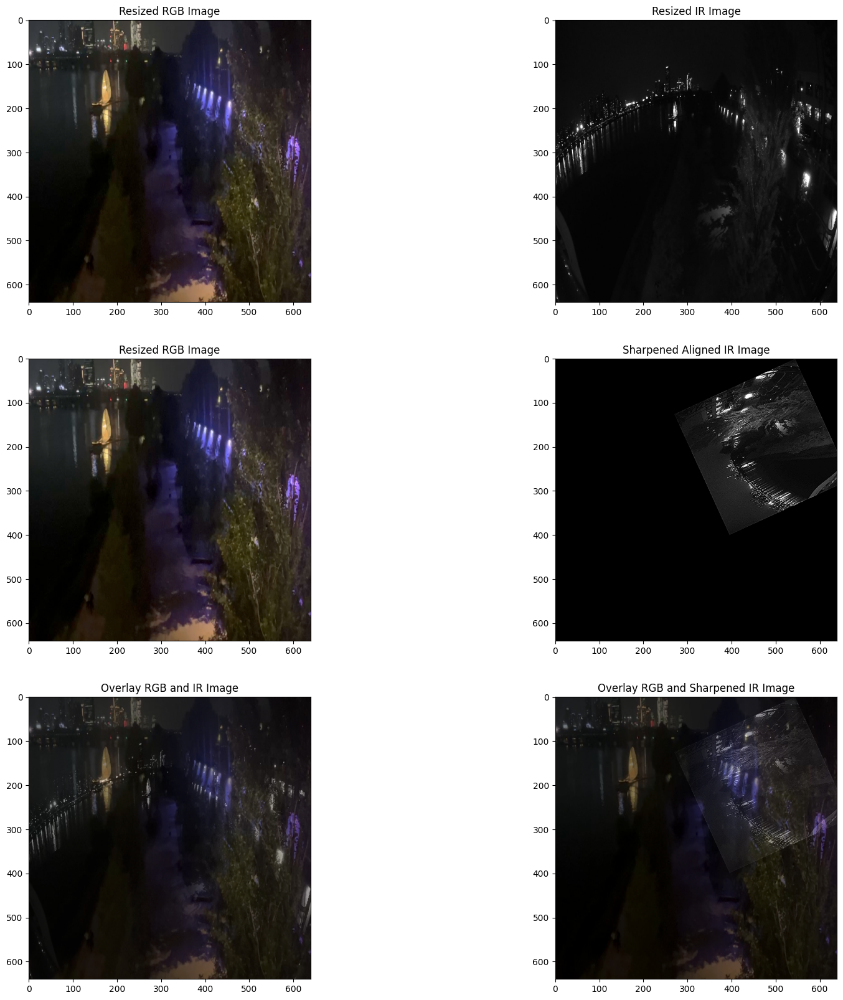

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 이미지 경로 설정
rgb_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/rgb2_0603.png'  # RGB 이미지 경로
ir_image_path = '/content/drive/MyDrive/Colab Notebooks/2024_1/capstone/img_process/fir_2_0603.jpg'    # IR 이미지 경로


# 이미지 읽기
rgb_image = cv2.imread(rgb_image_path)
ir_image = cv2.imread(ir_image_path)

# 이미지 리사이즈
resized_rgb_image = cv2.resize(rgb_image, (640, 640))
resized_ir_image = cv2.resize(ir_image, (640, 640))

# RGB 이미지의 평균 밝기 계산
mean_rgb = np.mean(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY))

# IR 이미지의 현재 평균 밝기 계산
mean_ir = np.mean(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY))

# 밝기 조절 인자 계산
alpha = mean_rgb / mean_ir
beta = 0  # 추가적인 밝기 조절이 필요 없으므로 0으로 설정

# 밝기 조절된 IR 이미지
bright_ir_image = cv2.convertScaleAbs(resized_ir_image, alpha=alpha, beta=beta)

# 이미지를 그레이스케일로 변환
gray_rgb = cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2GRAY)
gray_ir = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)

# ORB 검출기 생성
orb = cv2.ORB_create()

# 특징점과 서술자 검출
keypoints_rgb, descriptors_rgb = orb.detectAndCompute(gray_rgb, None)
keypoints_ir, descriptors_ir = orb.detectAndCompute(gray_ir, None)

# 매처 생성
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# 특징점 매칭
matches = bf.match(descriptors_rgb, descriptors_ir)

# 매칭 결과 정렬
matches = sorted(matches, key=lambda x: x.distance)

# 상위 3개의 매칭점 사용
matches = matches[:3]

# 매칭점 그리기
img_matches = cv2.drawMatches(resized_rgb_image, keypoints_rgb, bright_ir_image, keypoints_ir, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Affine Transformation을 위한 포인트 추출
points_rgb = np.float32([keypoints_rgb[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
points_ir = np.float32([keypoints_ir[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Affine Transformation 매트릭스 계산
matrix, _ = cv2.estimateAffinePartial2D(points_ir, points_rgb)

# IR 이미지를 RGB 이미지에 정렬
height, width, channels = resized_rgb_image.shape
ir_aligned = cv2.warpAffine(bright_ir_image, matrix, (width, height))

# 정렬된 IR 이미지에 샤프닝 적용
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])
sharpened_ir_aligned = cv2.filter2D(ir_aligned, -1, kernel)

# 채널 결합을 위한 준비
rgb_image_3channel = resized_rgb_image
ir_image_1channel = cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2GRAY)
bright_ir_1channel = cv2.cvtColor(bright_ir_image, cv2.COLOR_BGR2GRAY)
sharpened_ir_1channel = cv2.cvtColor(sharpened_ir_aligned, cv2.COLOR_BGR2GRAY)

# 4채널 이미지 생성
combined_image = np.concatenate((resized_rgb_image, sharpened_ir_1channel[..., np.newaxis]), axis=2)

# 오버레이 이미지 생성
alpha = 0.5  # 투명도 설정 (0.0 = 완전 투명, 1.0 = 완전 불투명)
overlay_image_1 = cv2.addWeighted(resized_rgb_image, alpha, cv2.cvtColor(ir_image_1channel, cv2.COLOR_GRAY2BGR), 1 - alpha, 0)
overlay_image_2 = cv2.addWeighted(resized_rgb_image, alpha, cv2.cvtColor(sharpened_ir_1channel, cv2.COLOR_GRAY2BGR), 1 - alpha, 0)

# 시각화
plt.figure(figsize=(20, 20))

# 첫 번째 줄: 리사이즈된 RGB 이미지, 리사이즈된 IR 이미지
plt.subplot(3, 2, 1)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(3, 2, 2)
plt.title('Resized IR Image')
plt.imshow(cv2.cvtColor(resized_ir_image, cv2.COLOR_BGR2RGB))

# 두 번째 줄: 리사이즈된 RGB 이미지, 샤프닝까지 적용된 최종 IR 이미지
plt.subplot(3, 2, 3)
plt.title('Resized RGB Image')
plt.imshow(cv2.cvtColor(resized_rgb_image, cv2.COLOR_BGR2RGB))

plt.subplot(3, 2, 4)
plt.title('Sharpened Aligned IR Image')
plt.imshow(cv2.cvtColor(sharpened_ir_aligned, cv2.COLOR_BGR2RGB))

# 세 번째 줄: RGB 이미지와 IR 이미지 오버레이
plt.subplot(3, 2, 5)
plt.title('Overlay RGB and IR Image')
plt.imshow(cv2.cvtColor(overlay_image_1, cv2.COLOR_BGR2RGB))

plt.subplot(3, 2, 6)
plt.title('Overlay RGB and Sharpened IR Image')
plt.imshow(cv2.cvtColor(overlay_image_2, cv2.COLOR_BGR2RGB))

plt.show()
